In [1]:
# Copyright 2025 Bytedance Ltd. and/or its affiliates.
# SPDX-License-Identifier: Apache-2.0

%load_ext autoreload
%autoreload 2

import os
os.environ["CUDA_VISIBLE_DEVICES"] = "4,5,6"
from copy import deepcopy
from typing import (
    Any,
    AsyncIterable,
    Callable,
    Dict,
    Generator,
    List,
    NamedTuple,
    Optional,
    Tuple,
    Union,
)
import requests
from io import BytesIO

from PIL import Image
import torch
from accelerate import infer_auto_device_map, load_checkpoint_and_dispatch, init_empty_weights

from data.transforms import ImageTransform
from data.data_utils import pil_img2rgb, add_special_tokens
from modeling.bagel import (
    BagelConfig, Bagel, Qwen2Config, Qwen2ForCausalLM, SiglipVisionConfig, SiglipVisionModel
)
from modeling.qwen2 import Qwen2Tokenizer
from modeling.bagel.qwen2_navit import NaiveCache
from modeling.autoencoder import load_ae
from safetensors.torch import load_file

from huggingface_hub import snapshot_download

save_dir = "/checkpoint/dream_v2/transfusion/BAGEL-7B-MoT"
# repo_id = "ByteDance-Seed/BAGEL-7B-MoT"
# cache_dir = save_dir + "/cache"

# snapshot_download(cache_dir=cache_dir,
#   local_dir=save_dir,
#   repo_id=repo_id,
#   local_dir_use_symlinks=False,
#   resume_download=True,
#   allow_patterns=["*.json", "*.safetensors", "*.bin", "*.py", "*.md", "*.txt"],
# )
model_path = save_dir  # Download from https://huggingface.co/ByteDance-Seed/BAGEL-7B-MoT

# LLM config preparing
llm_config = Qwen2Config.from_json_file(os.path.join(model_path, "llm_config.json"))
llm_config.qk_norm = True
llm_config.tie_word_embeddings = False
llm_config.layer_module = "Qwen2MoTDecoderLayer"

# ViT config preparing
vit_config = SiglipVisionConfig.from_json_file(os.path.join(model_path, "vit_config.json"))
vit_config.rope = False
vit_config.num_hidden_layers = vit_config.num_hidden_layers - 1

# VAE loading
vae_model, vae_config = load_ae(local_path=os.path.join(model_path, "ae.safetensors"))

# Bagel config preparing
config = BagelConfig(
    visual_gen=True,
    visual_und=True,
    llm_config=llm_config, 
    vit_config=vit_config,
    vae_config=vae_config,
    vit_max_num_patch_per_side=70,
    connector_act='gelu_pytorch_tanh',
    latent_patch_size=2,
    max_latent_size=64,
)

with init_empty_weights():
    language_model = Qwen2ForCausalLM(llm_config)
    vit_model      = SiglipVisionModel(vit_config)
    model          = Bagel(language_model, vit_model, config)
    model.vit_model.vision_model.embeddings.convert_conv2d_to_linear(vit_config, meta=True)

# Tokenizer Preparing
tokenizer = Qwen2Tokenizer.from_pretrained(model_path)
tokenizer, new_token_ids, _ = add_special_tokens(tokenizer)

# Image Transform Preparing
vae_transform = ImageTransform(1024, 512, 16)
vit_transform = ImageTransform(980, 224, 14)

In [2]:
max_mem_per_gpu = "80GiB"  # Modify it according to your GPU setting. On an A100, 80 GiB is sufficient to load on a single GPU.

device_map = infer_auto_device_map(
    model,
    max_memory={i: max_mem_per_gpu for i in range(torch.cuda.device_count())},
    no_split_module_classes=["Bagel", "Qwen2MoTDecoderLayer"],
)
print(device_map)

same_device_modules = [
    'language_model.model.embed_tokens',
    'time_embedder',
    'latent_pos_embed',
    'vae2llm',
    'llm2vae',
    'connector',
    'vit_pos_embed'
]

if torch.cuda.device_count() == 1:
    first_device = device_map.get(same_device_modules[0], "cuda:0")
    for k in same_device_modules:
        if k in device_map:
            device_map[k] = first_device
        else:
            device_map[k] = "cuda:0"
else:
    first_device = device_map.get(same_device_modules[0])
    for k in same_device_modules:
        if k in device_map:
            device_map[k] = first_device

# Thanks @onion-liu: https://github.com/ByteDance-Seed/Bagel/pull/8
model = load_checkpoint_and_dispatch(
    model,
    checkpoint=os.path.join(model_path, "ema.safetensors"),
    device_map=device_map,
    offload_buffers=True,
    dtype=torch.bfloat16,
    force_hooks=True,
    offload_folder="/tmp/offload"
)

model = model.eval()
print('Model loaded')

OrderedDict([('', 0)])


The safetensors archive passed at /checkpoint/dream_v2/transfusion/BAGEL-7B-MoT/ema.safetensors does not contain metadata. Make sure to save your model with the `save_pretrained` method. Defaulting to 'pt' metadata.


Model loaded


In [5]:
from inferencer import InterleaveInferencer
import random
import numpy as np

inferencer = InterleaveInferencer(
    model=model, 
    vae_model=vae_model, 
    tokenizer=tokenizer, 
    vae_transform=vae_transform, 
    vit_transform=vit_transform, 
    new_token_ids=new_token_ids
)

seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [6]:
# Image gen with think params 
t2i_think_params =dict(
    think=True,
    max_think_token_n=1000,
    do_sample=False,
    # text_temperature=0.3,
    cfg_text_scale=4.0,
    cfg_img_scale=1.0,
    cfg_interval=[0.4, 1.0],
    timestep_shift=3.0,
    num_timesteps=50,
    cfg_renorm_min=0.0,
    cfg_renorm_type="global",
)

# Edit with think params
edit_think_params = dict(
    think=True,
    max_think_token_n=1000,
    do_sample=False,
    # text_temperature=0.3,
    cfg_text_scale=4.0,
    cfg_img_scale=2.0,
    cfg_interval=[0.0, 1.0],
    timestep_shift=3.0,
    num_timesteps=50,
    cfg_renorm_min=0.0,
    cfg_renorm_type="text_channel",
)

# Failed Generation then edit tests

An orange cat sitting in front of a coffee cup on a table.
----------


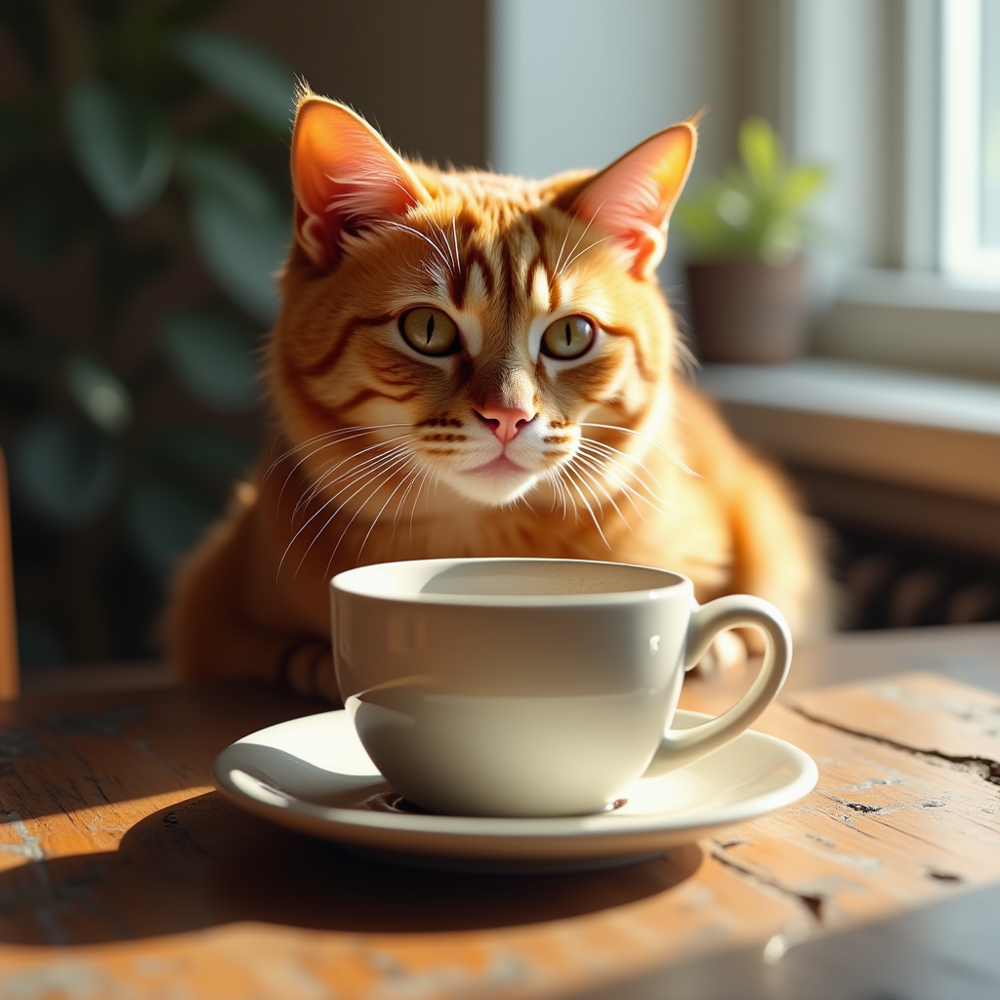

Thinking: <think>
The model should generate an image where the orange cat is positioned directly in front of the coffee cup, creating a sense of proximity and interaction.
The complete, polished prompt is: An ultra-realistic image of an orange cat sitting directly in front of a ceramic coffee cup on a wooden table, with the cat's body and face clearly visible and in sharp focus. The coffee cup is placed on a saucer, and the scene is lit with soft, natural daylight streaming in from a nearby window, creating gentle shadows and a warm, inviting atmosphere. The table surface is textured and slightly worn, adding a cozy, lived-in feel to the setting. The cat's fur is detailed and vibrant, with a glossy sheen, while the coffee cup has a simple yet elegant design, emphasizing the interaction between the two subjects. The overall composition is balanced and intimate, with a shallow depth of field creating a subtle bokeh effect in the background.
</think>


In [21]:
prompt = 'An orange cat sitting in front of a coffee cup on a table.'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
cat_coffee_img = output_dict['image']

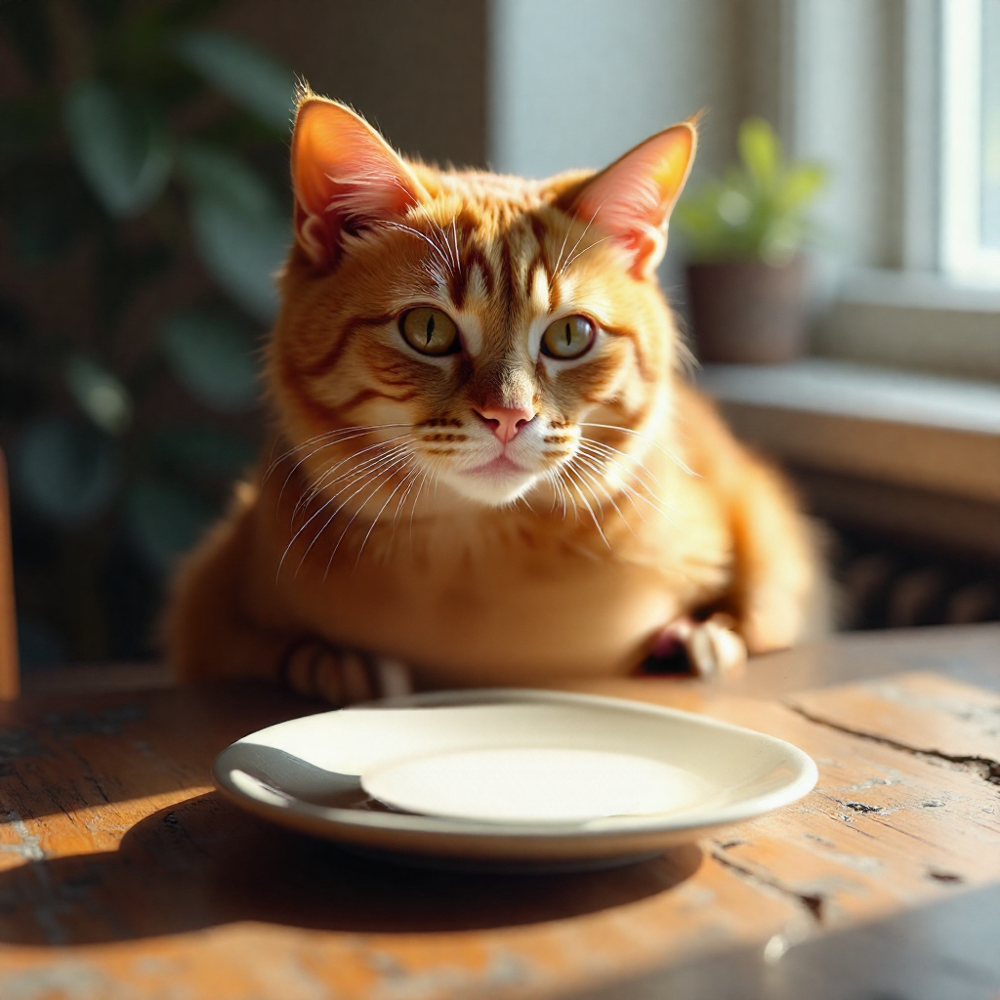

Thinking: <think>
The user wants the coffee cup to be placed behind the cat while keeping the rest of the image intact. The cat's position and the background should remain unchanged, but the cup and saucer need to be repositioned to sit behind the cat, ensuring the lighting and shadows match the original scene.
</think>


In [39]:
edit_output_dict = inferencer(
    image=cat_coffee_img, 
    text="The coffee cup is moved behind the cat", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

A dog lying down to the right of some socks
----------


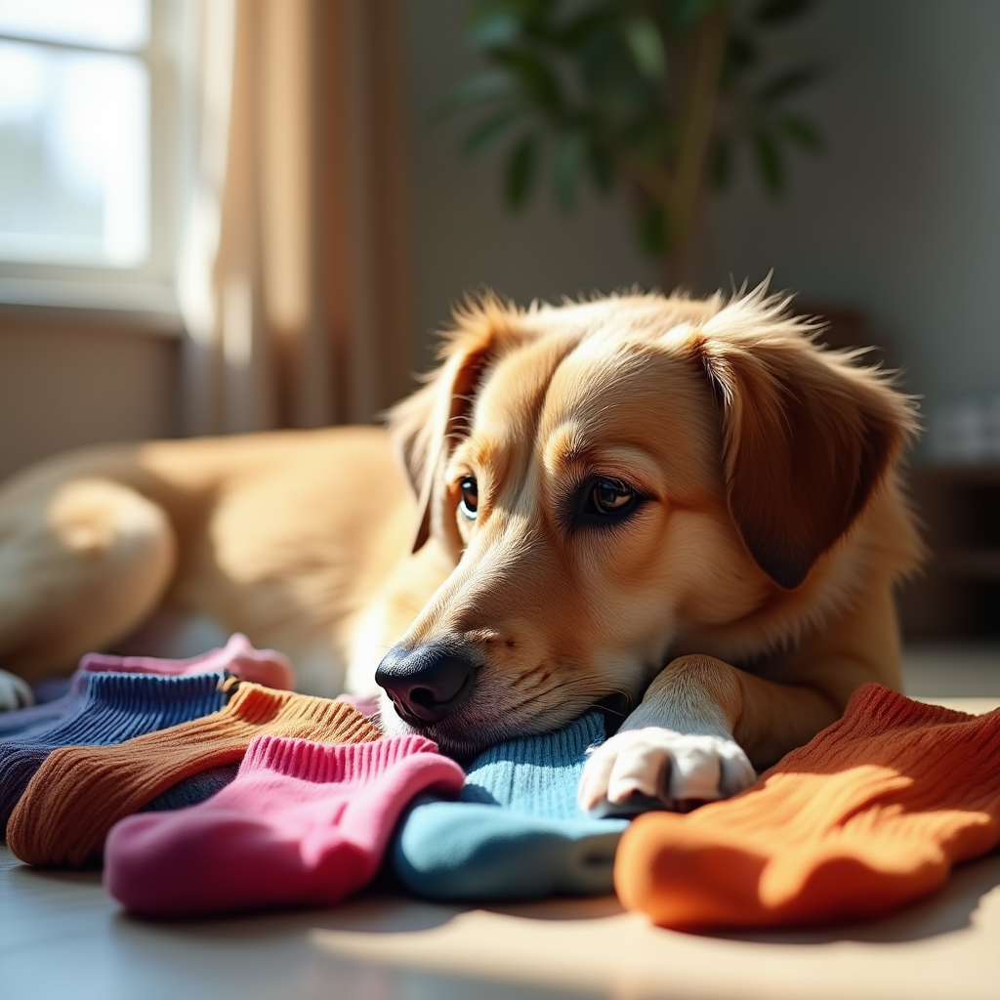

Thinking: <think>
The model should generate an image where the dog is positioned to the right of the socks, clearly showing spatial separation between the two objects.
Here’s the full, detailed prompt: A cozy indoor scene featuring a relaxed dog lying down to the right of a neatly arranged pile of colorful socks. The dog appears calm and comfortable, with soft fur and a gentle expression, while the socks are vibrant and varied in color, creating a cheerful contrast. The setting is warmly lit with natural light streaming in from a nearby window, casting soft shadows and enhancing the inviting atmosphere. The perspective is slightly angled, capturing both the dog and the socks in a balanced composition, with a clean and minimalistic background to emphasize the objects. Ultra-realistic details highlight the textures of the dog’s fur, the fabric of the socks, and the subtle interplay of light and shadow.
</think>


In [51]:
prompt = "A dog lying down to the right of some socks"
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
dog_img = output_dict['image']

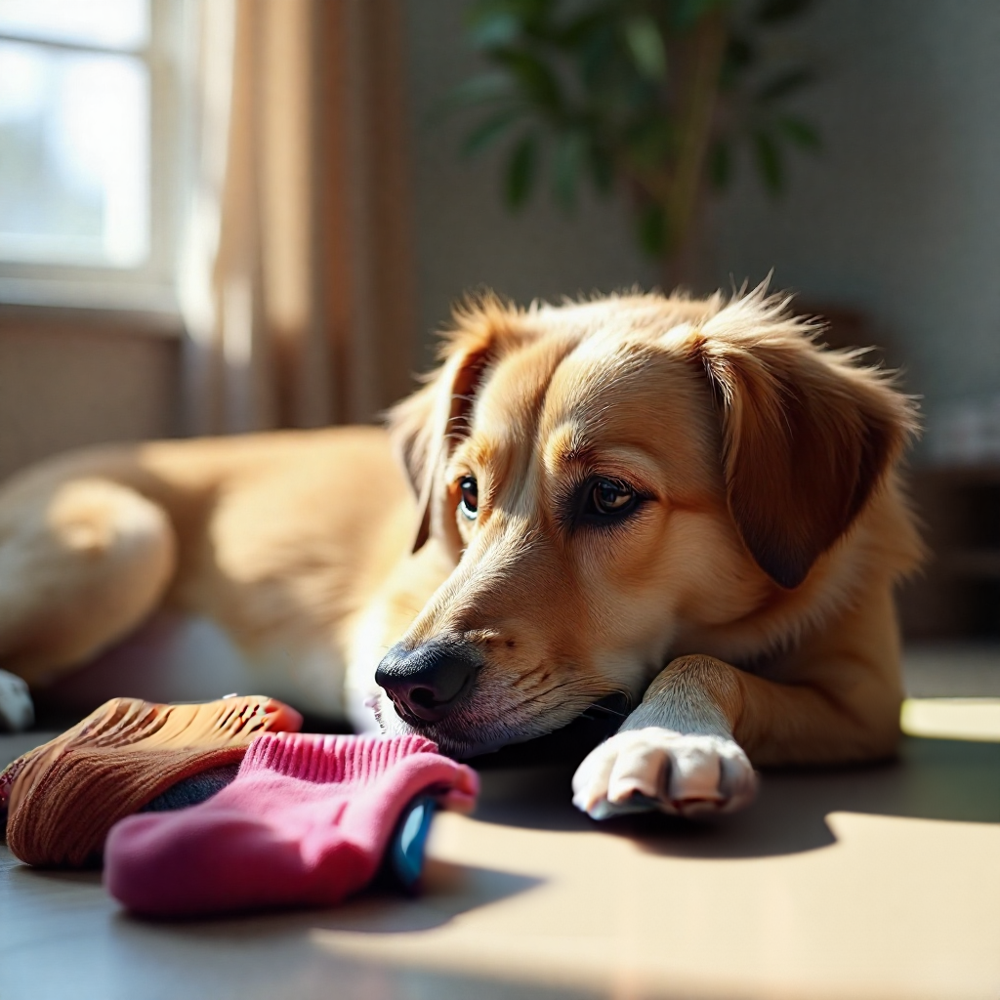

Thinking: <think>
The user wants the socks to be moved away from the dog and placed to the left. The dog's position and the overall layout of the image should remain unchanged. The socks should be repositioned to the left side of the image, ensuring they are clearly visible and separate from the dog.
</think>


In [59]:
edit_output_dict = inferencer(
    image=dog_img, 
    text="Move the socks away from the dog towards the left", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

A bell pepper laying on its side
----------


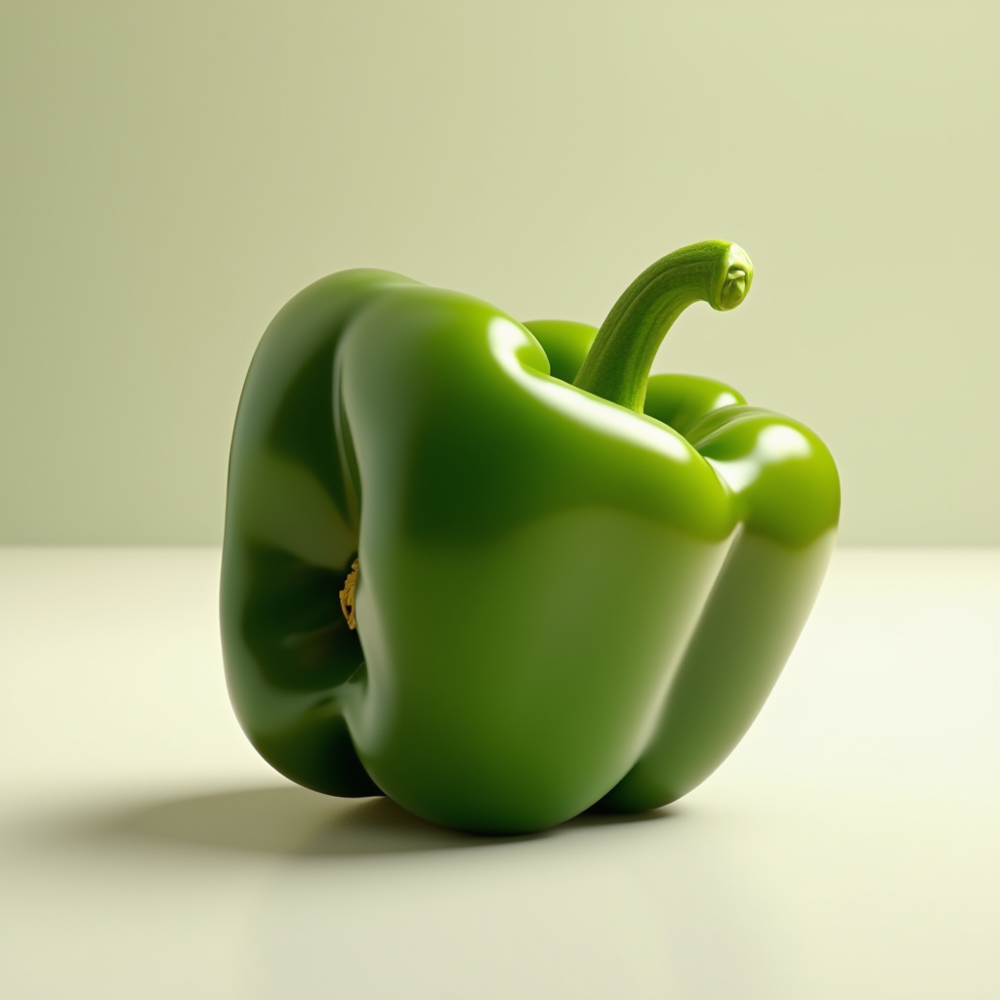

Thinking: <think>
The model should generate an image of a bell pepper lying horizontally on a flat surface, with its curved shape and smooth texture clearly visible.
Here’s the expanded prompt: A vibrant, ripe bell pepper lying horizontally on a smooth, flat surface, showcasing its curved shape and smooth texture in vivid detail. The pepper is brightly colored, with rich green tones and subtle highlights that emphasize its glossy surface. The lighting is soft and natural, creating gentle shadows and reflections that enhance the realism of the scene. The background is minimal and unobtrusive, ensuring full focus on the bell pepper. Ultra-realistic rendering with sharp details and lifelike textures.
</think>


In [24]:
prompt = 'A bell pepper laying on its side'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
bell_pepper_img = output_dict['image']

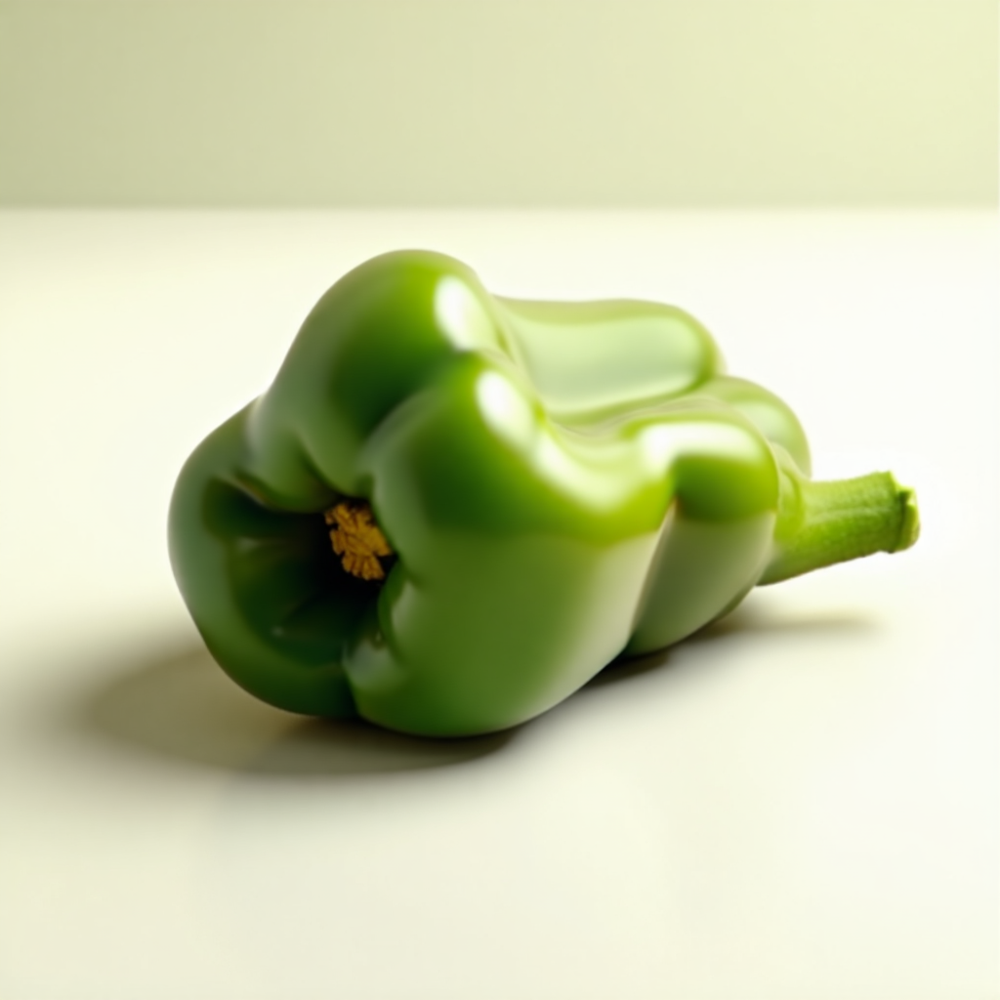

Thinking: <think>
The user wants the bell pepper to be repositioned to lie flat on its side. The original image shows the pepper upright, so the transformation involves adjusting its orientation. The stem and base should remain visible, but the pepper's curved shape should be flattened horizontally. The background and lighting should stay consistent to maintain realism.
</think>


In [ ]:
edit_output_dict = inferencer(
    image=bell_pepper_img, 
    text="Have the bell pepper lay down on its side", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

A motorcycle lying down
----------


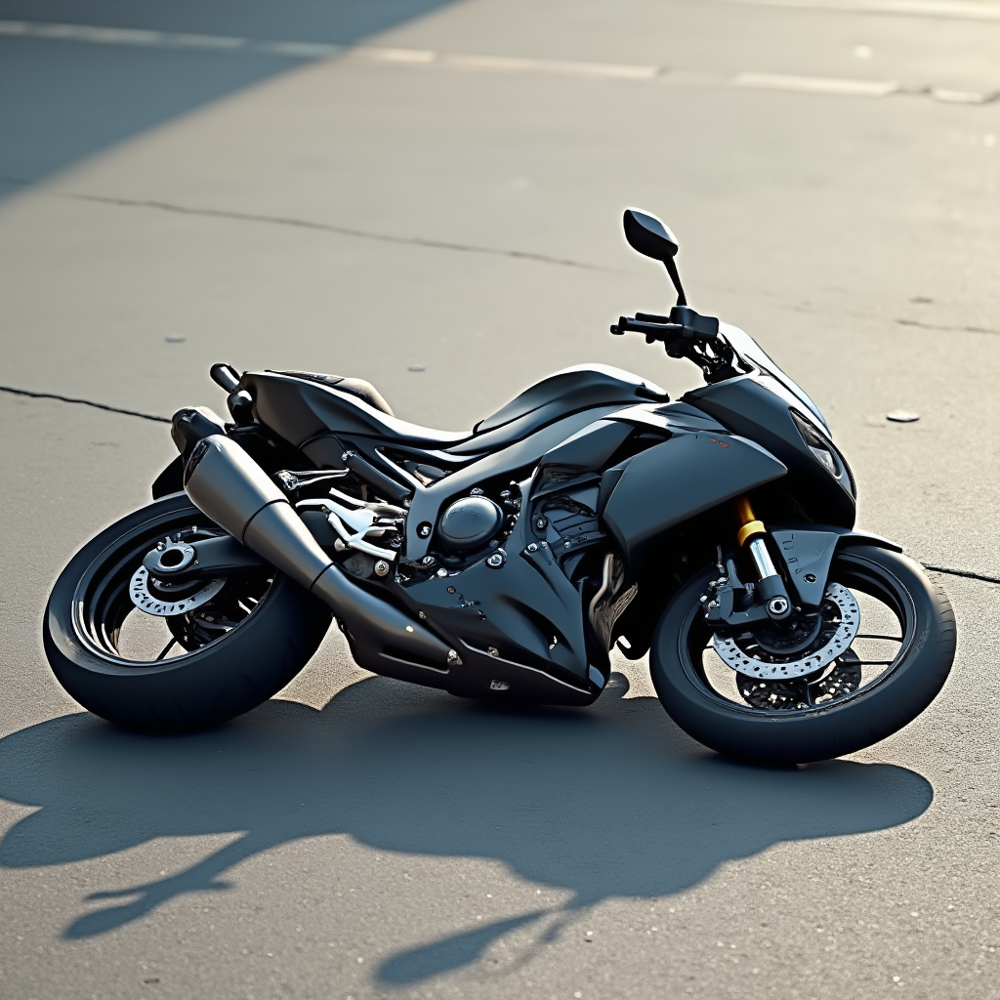

Thinking: <think>
The model should generate an image of a motorcycle that is positioned horizontally on the ground, as if it has fallen over.
Here’s the full, detailed prompt: A sleek, modern motorcycle lying horizontally on the ground, as if it has fallen over, with its wheels and frame clearly visible. The scene is set outdoors on a smooth, flat surface, such as asphalt or concrete, under natural daylight with soft shadows. The motorcycle is detailed and realistic, showcasing its design, including the tires, handlebars, and bodywork. The overall atmosphere is neutral and unobtrusive, focusing entirely on the fallen motorcycle without any distractions. Ultra-realistic rendering with sharp details and balanced lighting.
</think>


In [29]:
prompt = 'A motorcycle lying down'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
motorcycle_img = output_dict['image']

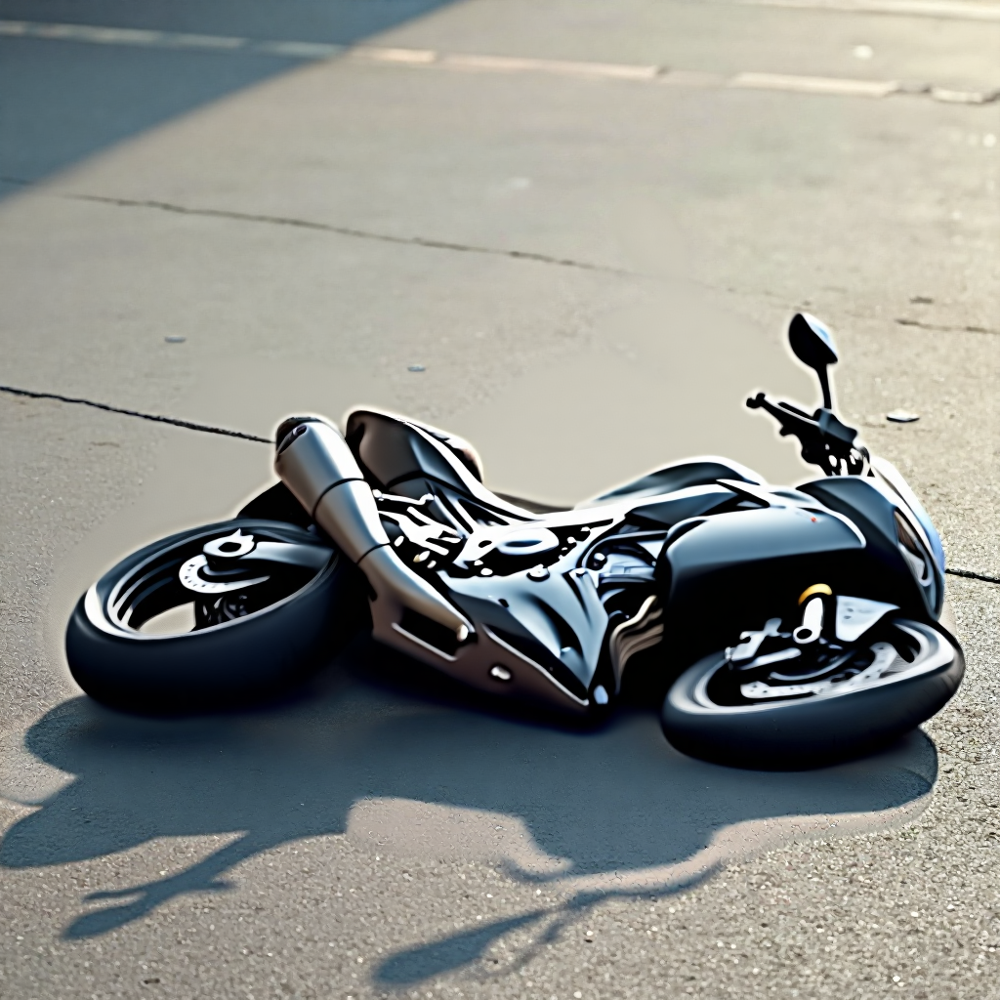

Thinking: <think>
The user wants the motorcycle to appear as if it is lying down on the ground. The structure and layout of the image should remain the same, with the motorcycle's position adjusted to a horizontal orientation. The lighting, shadows, and background should also be preserved to maintain realism.
</think>


In [30]:
edit_output_dict = inferencer(
    image=motorcycle_img, 
    text="Have the motorcycle be lying down on the ground", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

A highway sign showing 60 MPH
----------


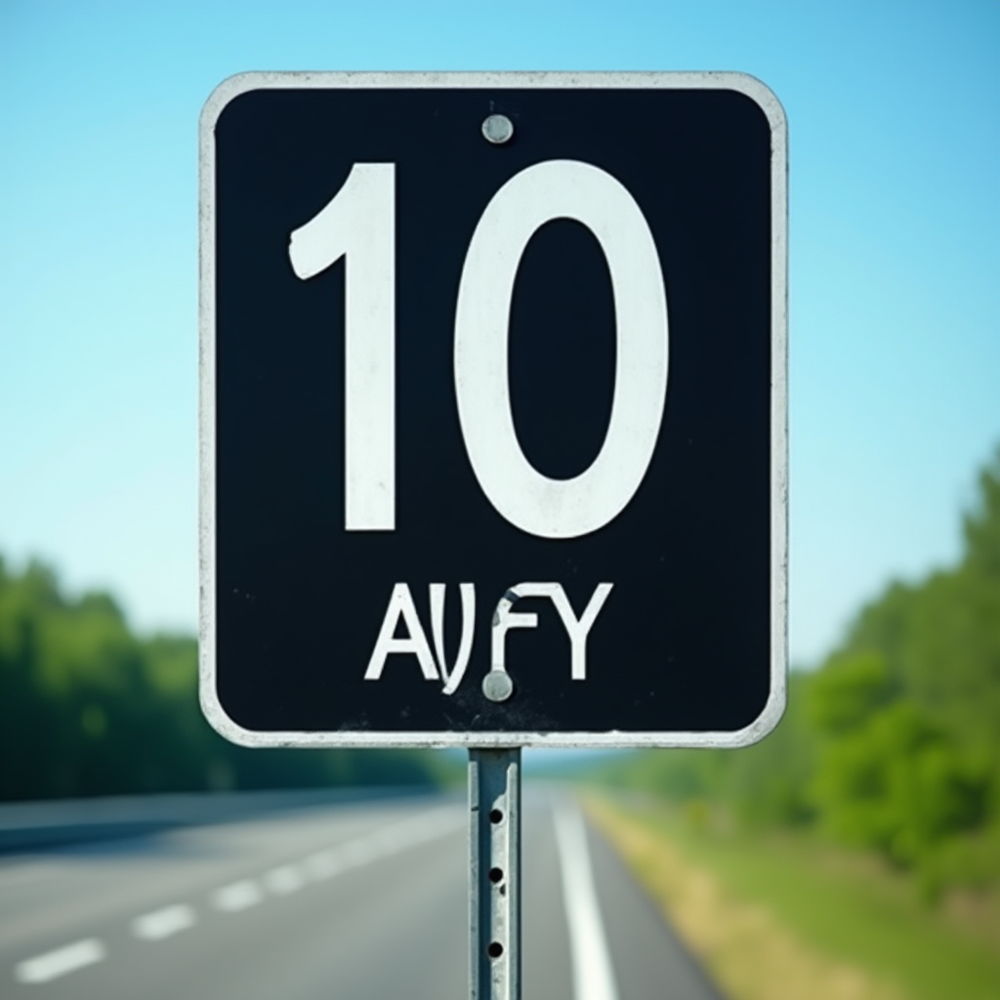

Thinking: <think>
The model should generate an image of a road sign with the number '60' prominently displayed, accompanied by the text 'MPH' to indicate the speed limit in miles per hour.
Here’s the full, detailed prompt: A clear and detailed image of a road sign displaying the number '60' prominently in bold, white font against a black background, with the text 'MPH' directly below in smaller white font. The sign is mounted on a standard metal post, set against a realistic outdoor highway scene with blurred greenery and a clear blue sky in the background, ensuring the sign is the focal point. The lighting is natural and bright, suggesting daytime, with a crisp and clean aesthetic to emphasize clarity and precision.
</think>


In [34]:
prompt = 'A highway sign showing 60 MPH'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
mph_img = output_dict['image']

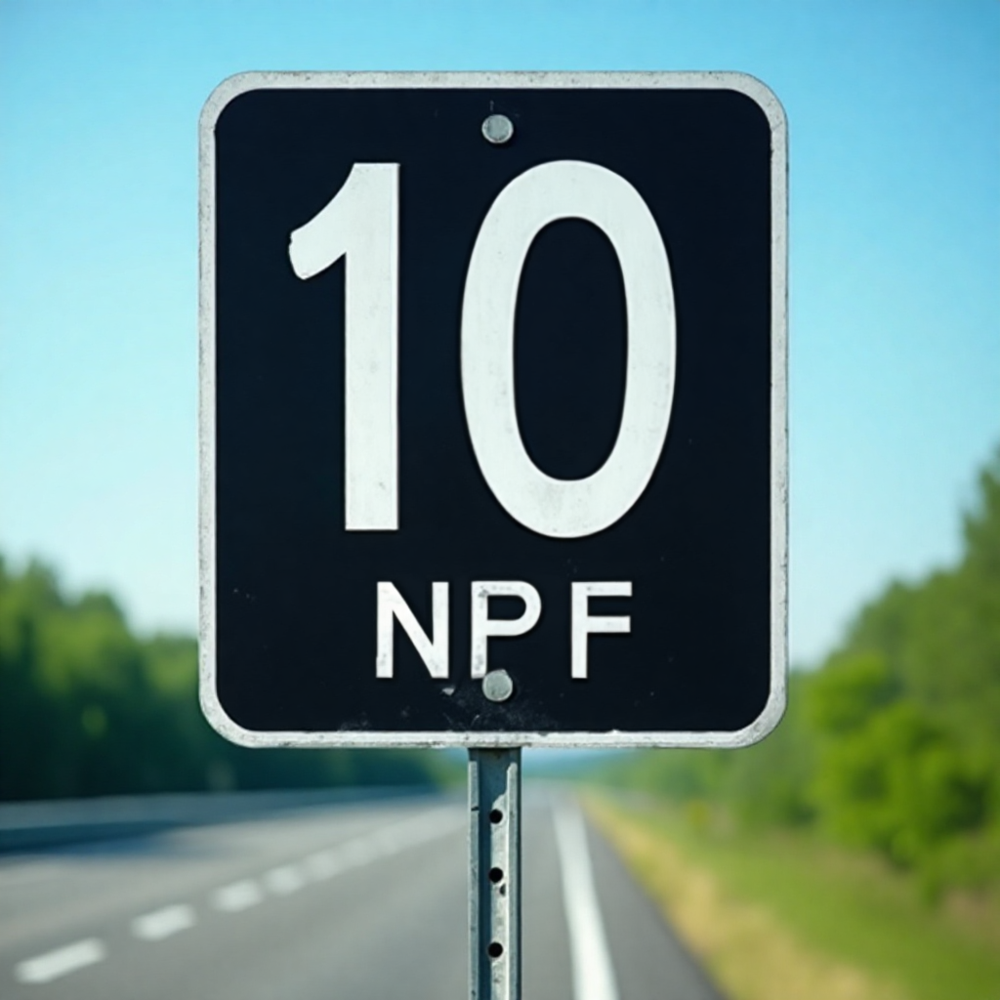

Thinking: <think>
The user wants the number "10" replaced with "60" and the text "AVFY" changed to "MPH." The structure and layout of the sign, including its black background, white text, and placement on the pole, should remain unchanged. Only the numerical value and text are modified to meet the request.
</think>


In [40]:
edit_output_dict = inferencer(
    image=mph_img, 
    text="Change the number to 60 and the text to \"MPH\"", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

A piece of paper folded in half
----------


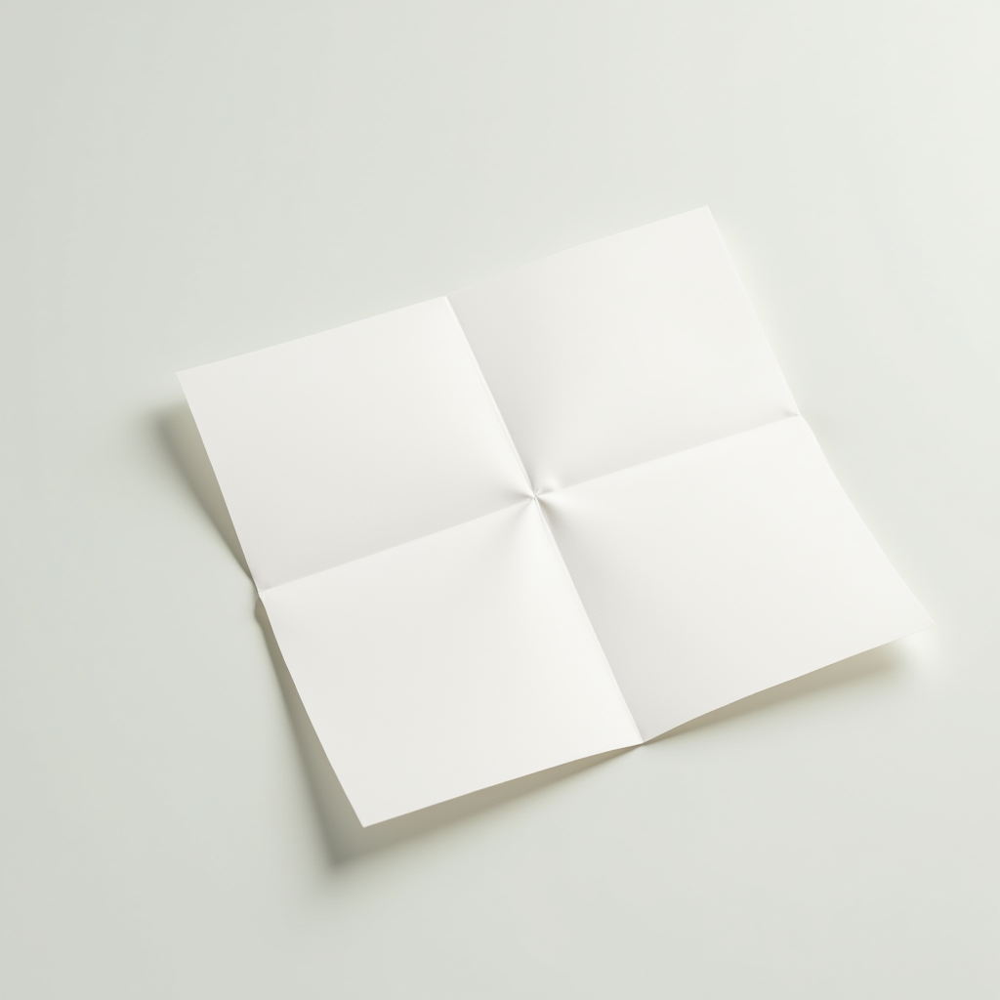

Thinking: <think>
The model should generate an image showing a flat piece of paper that has been folded neatly in half, with the crease clearly visible and the two halves aligned symmetrically.
Here’s the expanded prompt: A flat piece of paper folded neatly in half, with a crisp, clean crease running down the center, showcasing perfect symmetry. The paper is smooth and slightly textured, with a neutral white or light pastel color, resting on a minimalistic, softly lit surface. The lighting is even and diffused, creating a calm and neutral atmosphere, with no distracting elements in the background. Ultra-realistic details emphasize the paper's texture and the sharpness of the crease, ensuring a clean and precise visual presentation.
</think>


In [42]:
prompt = 'A piece of paper folded in half'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
paper_img = output_dict['image']

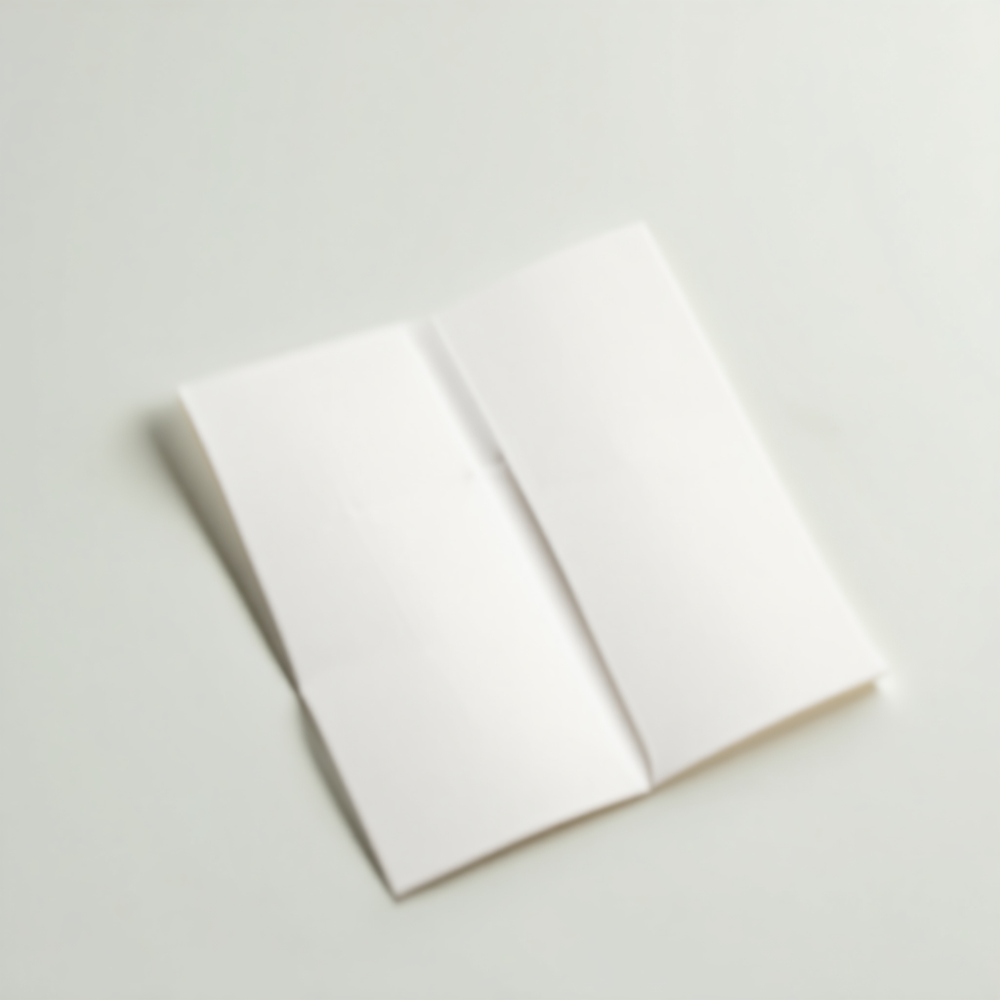

Thinking: <think>
The user wants the paper to be folded in half, reducing its current four-folded state to a single fold. The answer image should show the paper folded neatly in half, maintaining the same orientation and background as the question image. The folds should be clean and symmetrical.
</think>


In [49]:
edit_output_dict = inferencer(
    image=paper_img, 
    text="Only fold the paper in half", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

Fresh fruits all cut in half
----------


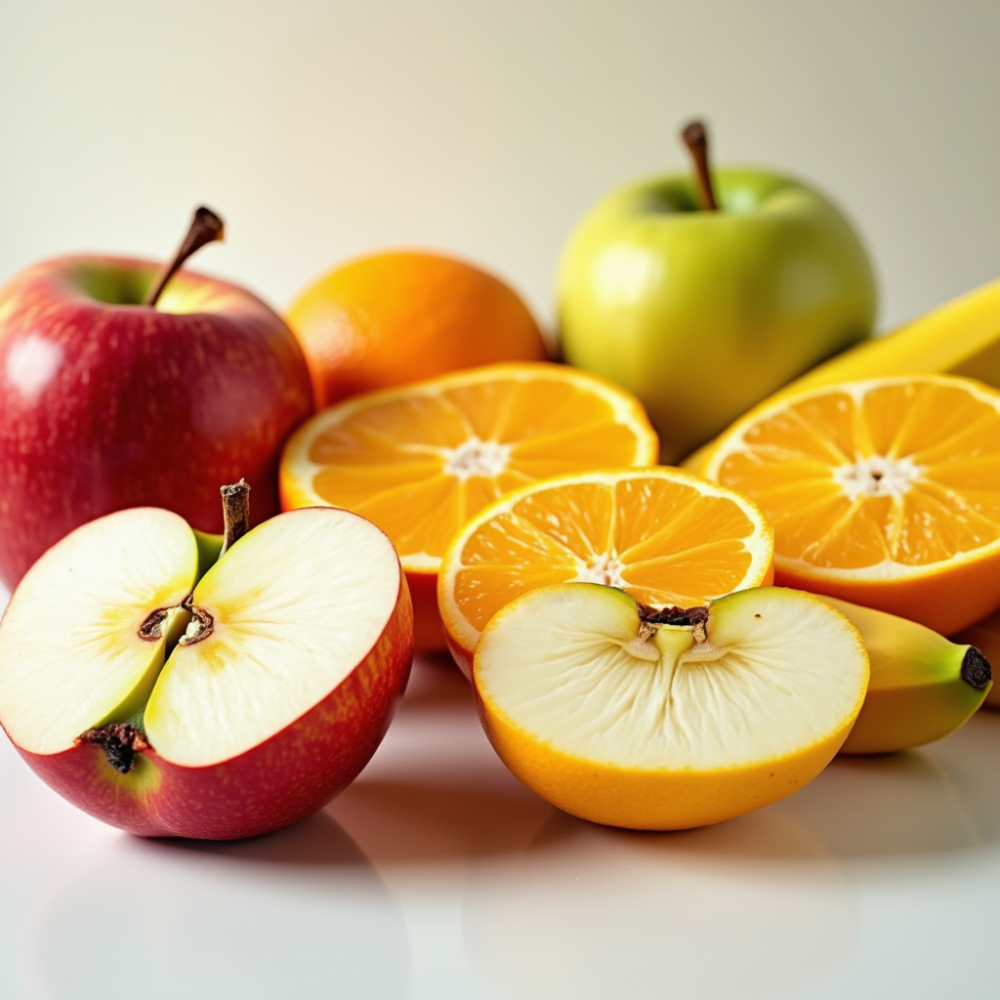

Thinking: <think>
The model should generate an image showing a variety of fruits, such as apples, oranges, and bananas, each cut in half to reveal their inner textures and colors.
The complete, polished prompt is: A vibrant and ultra-realistic image of a variety of fresh fruits, each cut in half to showcase their inner textures and colors. The fruits include apples, oranges, and bananas, arranged neatly on a clean, neutral surface. The apples reveal crisp, juicy flesh with a mix of red and green hues, the oranges display bright, segmented flesh with a vivid orange tone, and the bananas show creamy, pale yellow interiors. The lighting is soft and natural, with gentle shadows and highlights that emphasize the freshness and detail of the fruit. The overall atmosphere is inviting and appetizing, with a focus on the natural beauty and textures of the cut fruits.
</think>


In [43]:
prompt = 'Fresh fruits all cut in half'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
fruits_img = output_dict['image']

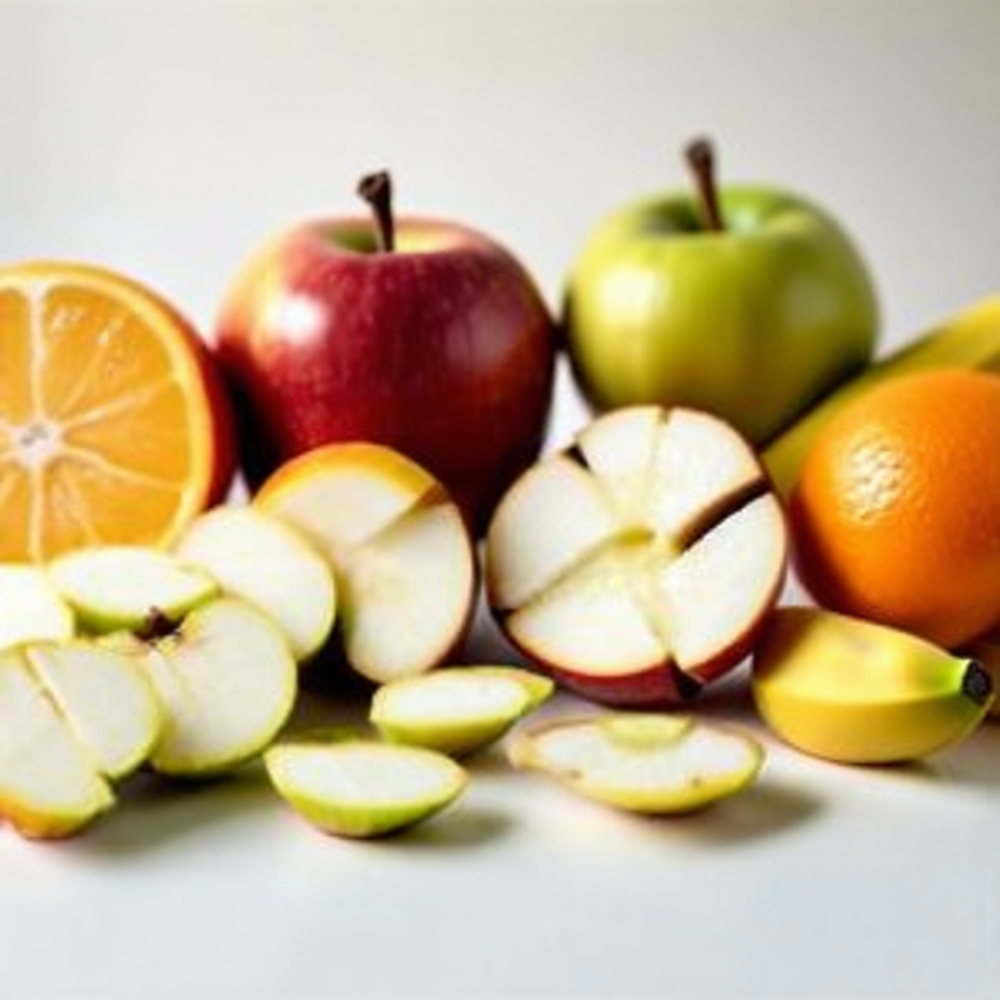

Thinking: <think>
The user wants the fruits in the image to be sliced into smaller pieces while maintaining their original arrangement and layout. The structure and positions of the fruits should remain the same, but each fruit should be divided into smaller, uniform slices. The answer image reflects this by showing the fruits sliced into smaller portions while preserving the overall composition.
</think>


In [48]:
edit_output_dict = inferencer(
    image=fruits_img, 
    text="Slice all the fruits", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

A tray of 6 cookies
----------


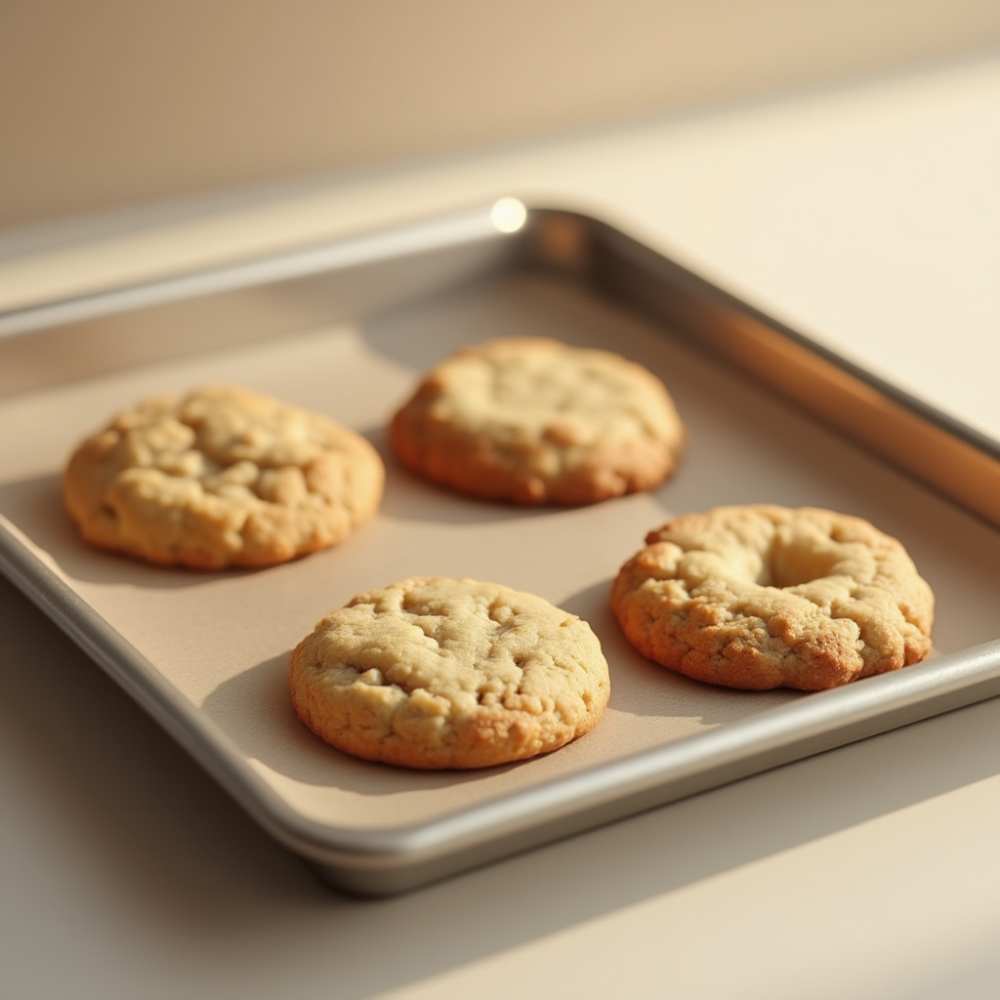

Thinking: <think>
The model should generate an image showing a tray with six cookies evenly spaced, each appearing slightly different in size and shape, demonstrating the concept of variation.
Here’s the full, detailed prompt: A tray of six cookies, each uniquely shaped and sized, arranged evenly across the tray to showcase variation in form and texture. The cookies have a warm, golden-brown color, with subtle imperfections and slight differences in size to emphasize individuality. The tray is simple and neutral, placed on a clean, softly lit surface, with a natural and inviting atmosphere. The lighting is warm and diffused, highlighting the cookies' details and creating a cozy, appetizing mood. Ultra-realistic, with a focus on texture and realism.
</think>


In [54]:
prompt = 'A tray of 6 cookies'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
cookies_img = output_dict['image']

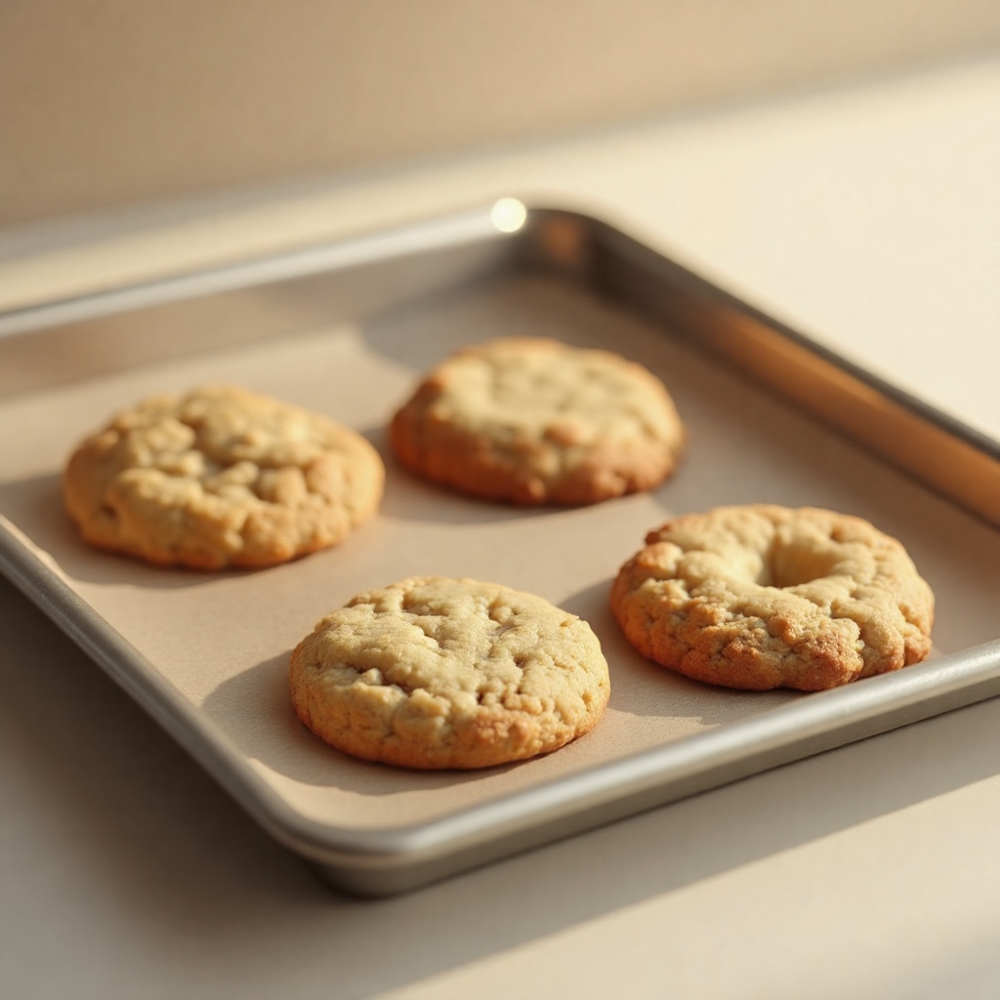

Thinking: <think>
The user wants to add two more cookies to the tray while keeping the original layout and structure intact. The new cookies should be placed symmetrically, ensuring the tray remains balanced. The lighting, shadows, and overall composition should remain consistent with the original image.
</think>


In [63]:
edit_output_dict = inferencer(
    image=cookies_img, 
    text="Add 2 cookies to the tray", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

5 birds sitting on a power line
----------


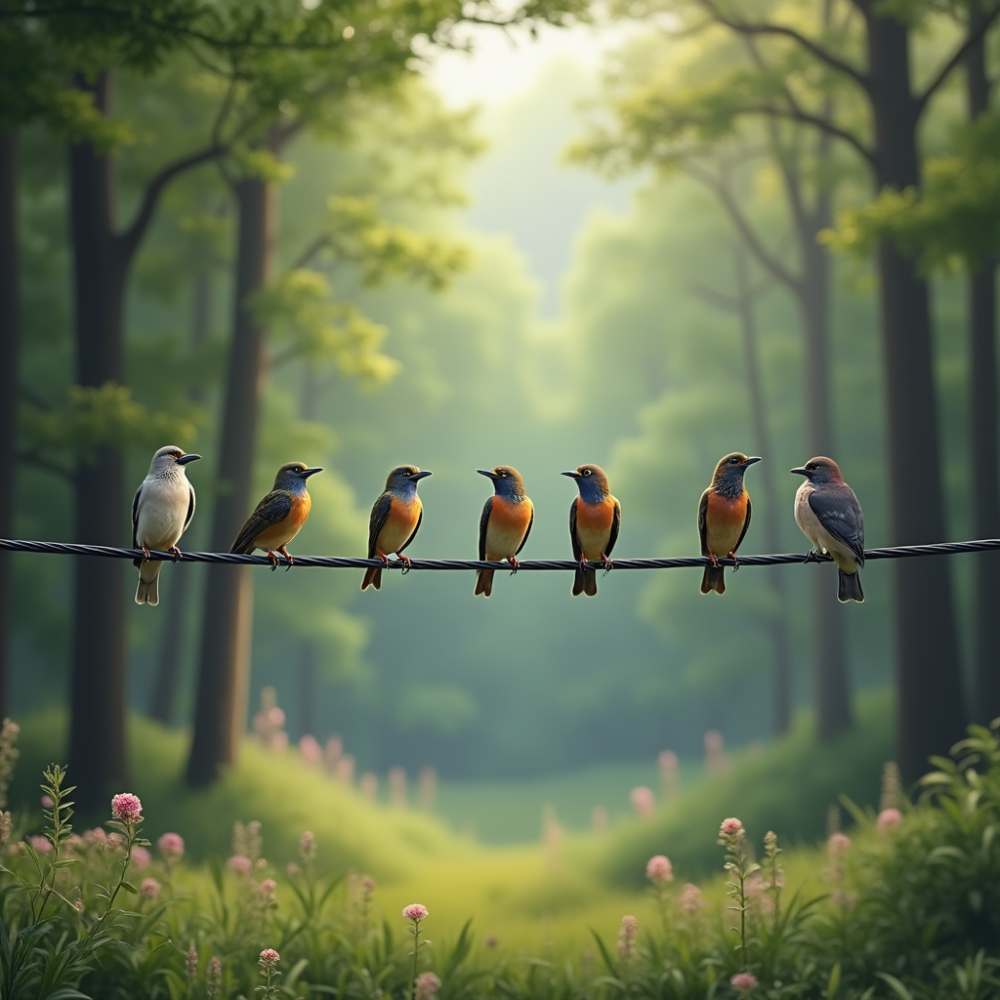

Thinking: <think>
The model should generate an image of five birds perched on a single power line, spaced evenly apart, with the scene set in a natural outdoor environment like a forest or park.
The refined prompt is: Five birds perched evenly spaced on a single power line, each bird distinct in species and color, set against a serene natural outdoor backdrop of a lush forest or park. The scene is bathed in soft, natural daylight with gentle shadows, emphasizing the tranquil atmosphere. The power line stretches horizontally across the frame, with the birds positioned at regular intervals, creating a balanced composition. The surrounding environment features dense green foliage, tall trees, and subtle hints of wildflowers, all rendered in ultra-realistic detail to capture the beauty of the natural setting. The mood is peaceful and harmonious, with a focus on the delicate interplay of light and texture.
</think>


In [64]:
prompt = '5 birds sitting on a power line'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")
birds_img = output_dict['image']

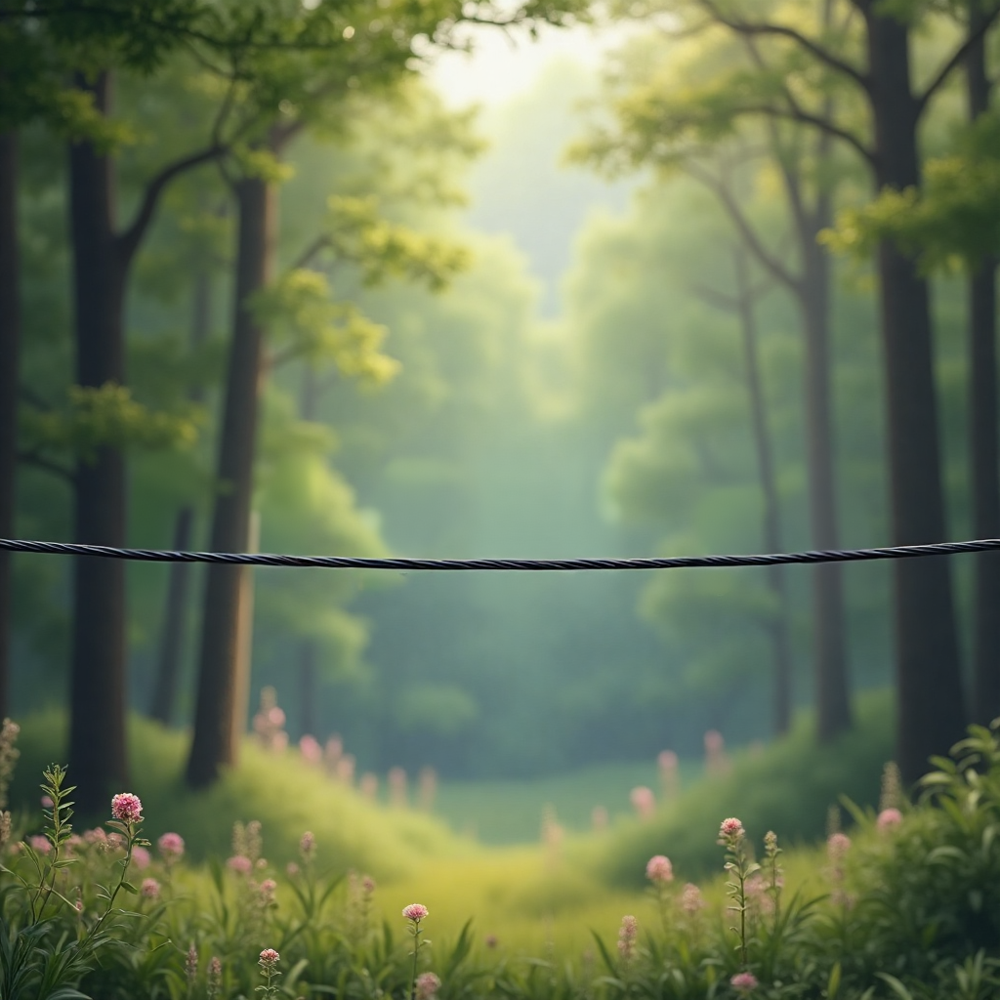

Thinking: <think>
The user wants two birds removed from the wire while keeping the rest of the image intact. The structure and layout of the image, including the forest background, flowers, and remaining birds, should remain unchanged. The two birds to be removed should be seamlessly blended into the wire and background to maintain realism.
</think>


In [70]:
edit_output_dict = inferencer(
    image=birds_img, 
    text="Remove 2 birds", 
    **edit_think_params
)
display(edit_output_dict['image'])
print(f"Thinking: {edit_output_dict['text']}")

## Their original example

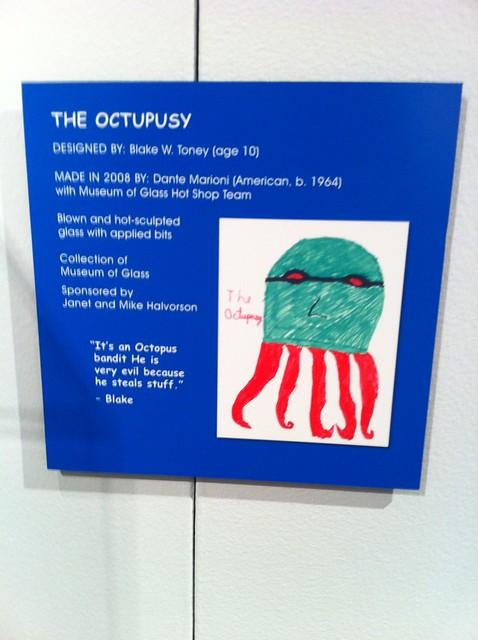

----------
<think>
To create a video game character resembling the Octupusy, I first analyze the design elements from the question_image. The Octupusy is a whimsical, cartoonish creature with a green body, red tentacles, and a mischievous expression. Its design is playful and slightly menacing, which could inspire a character that balances fun and danger.

The question_text asks for a video game character, so I consider how to translate the Octupusy's traits into a digital form. The character should retain the green body and red tentacles while incorporating features that make it distinctively "evil" and "stealing." For example, the character could have glowing eyes, a sinister grin, and perhaps a mischievous pose to emphasize its malevolent nature.

When describing the answer image, I would note that the character is a 3D model with a green body and red tentacles, similar to the Octupusy. The character has a menacing expression, glowing red eyes, and a slightly sinister pose, such as 

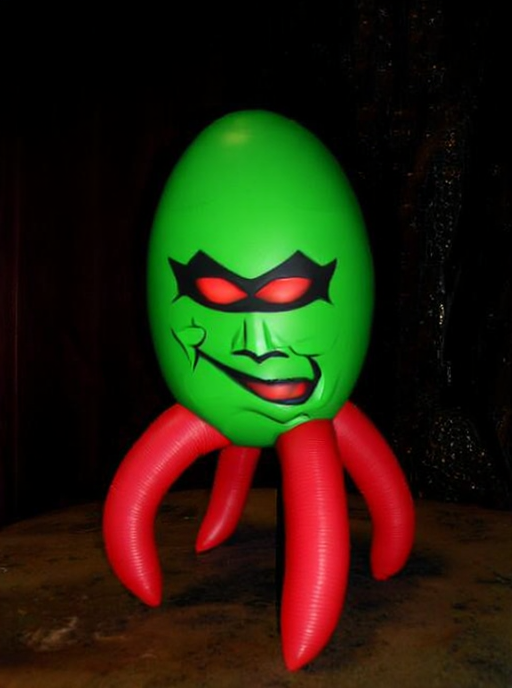

In [19]:
image = Image.open('test_images/octupusy.jpg')
prompt = 'Could you create a video game character that resembles the Octupusy?'

display(image)
print('-'*10)
output_dict = inferencer(image=image, text=prompt, **edit_think_params)
print(output_dict['text'])
display(output_dict['image'])